In [1]:
import pickle
from helper_fxns import convert_param_vec_dict_to_param_dict, gelman_rubin_trace_dict, print_convergence_summary, sample_plots, create_trace_matrix, plot_histograms
from earm.lopez_embedded import model
%matplotlib inline
import os
import numpy as np
from corner import corner
import matplotlib.pyplot as plt
import seaborn as sns

/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)
/Users/Erin/Library/Python/2.7/lib/python/site-packages/IPython/utils/traitlets.py:5: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  warn("IPython.utils.traitlets has moved to a top-level traitlets package.")


In [2]:
os.chdir('/Users/Erin/git/accre_data_analysis/gamma_levels_25000burnin/')

In [3]:
traces = {}
for trace in ['a', 'b', 'c']:
    traces[trace] = np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_sampled_params_chain_0.npy')
    for cont in range(2, 4):
        old = traces[trace]
        traces[trace] = np.concatenate([old, np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_sampled_params_chain_0.npy')])
    traces[trace] = [traces[trace]]
    for chain in range(1, 3):
        traces[trace].append(np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_sampled_params_chain_'+str(chain)+'.npy'))
        for cont in range(2, 4):
            old = traces[trace][chain]
            traces[trace][chain] = np.concatenate([old, np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_sampled_params_chain_'+str(chain)+'.npy')])

In [4]:
logps = {}
for trace in ['a', 'b', 'c']:
    logps[trace] = np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_logps_chain_0.npy')
    for cont in range(2, 4):
        old = logps[trace]
        logps[trace] = np.concatenate([old, np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_logps_chain_0.npy')])
    logps[trace] = [logps[trace]]
    for chain in range(1, 3):
        logps[trace].append(np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+'_logps_chain_'+str(chain)+'.npy'))
        for cont in range(2, 4):
            old = logps[trace][chain]
            logps[trace][chain] = np.concatenate([old, np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+str(trace)+str(cont)+'_logps_chain_'+str(chain)+'.npy')])

In [5]:
traces['a'][0].shape

(150000, 105)

In [6]:
param_trace_dicts = {}
param_trace_dict_a = {}
gelman_rubin_dicts = {}
param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]
for run in ['a', 'b', 'c']:
    for i, param in enumerate(model.parameters_rules()):
        param_trace_dict_a[param.name] = [traces[run][chain][:,i] for chain in range(len(traces[run]))]
    param_trace_dicts[run] = param_trace_dict_a
    gelman_rubin_dicts[run] = gelman_rubin_trace_dict(param_trace_dict_a)
    param_trace_dict_a = {}
    param_trace_dict_a['param_list'] = [param.name for param in model.parameters_rules()]

In [7]:
print_convergence_summary(param_trace_dicts['a'])

Number of parameters with GR below 1.2:  101  of  105  parameters.
Percent of parameters with GR below 1.2:  96.1904761905
Number of parameters with GR below 1.1:  79  of  105  parameters.
Percent of parameters with GR below 1.1:  75.2380952381


[101, 96.19047619047619, 79, 75.23809523809524]

In [8]:
print_convergence_summary(param_trace_dicts['b'])

Number of parameters with GR below 1.2:  103  of  105  parameters.
Percent of parameters with GR below 1.2:  98.0952380952
Number of parameters with GR below 1.1:  94  of  105  parameters.
Percent of parameters with GR below 1.1:  89.5238095238


[103, 98.09523809523809, 94, 89.52380952380953]

In [9]:
print_convergence_summary(param_trace_dicts['c'])

Number of parameters with GR below 1.2:  103  of  105  parameters.
Percent of parameters with GR below 1.2:  98.0952380952
Number of parameters with GR below 1.1:  90  of  105  parameters.
Percent of parameters with GR below 1.1:  85.7142857143


[103, 98.09523809523809, 90, 85.71428571428571]

In [12]:
print_convergence_summary(param_trace_dicts['d'])

Number of parameters with GR below 1.2:  99  of  105  parameters.
Percent of parameters with GR below 1.2:  94.2857142857
Number of parameters with GR below 1.1:  86  of  105  parameters.
Percent of parameters with GR below 1.1:  81.9047619048


[99, 94.28571428571428, 86, 81.9047619047619]

150000
3
150000


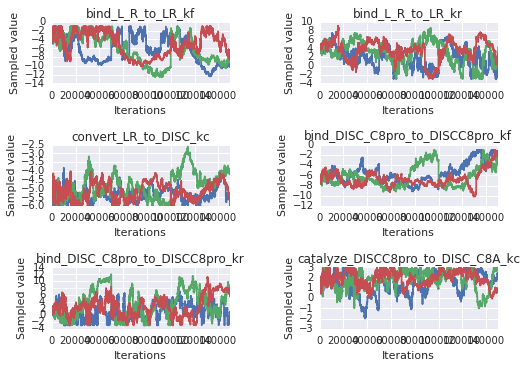

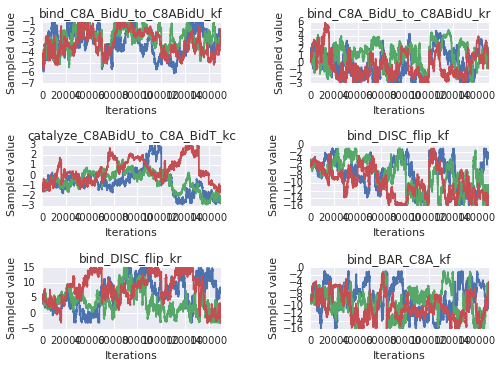

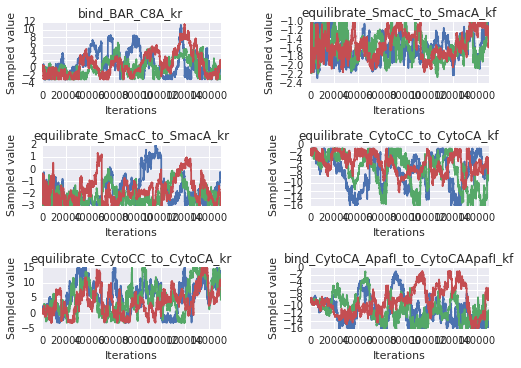

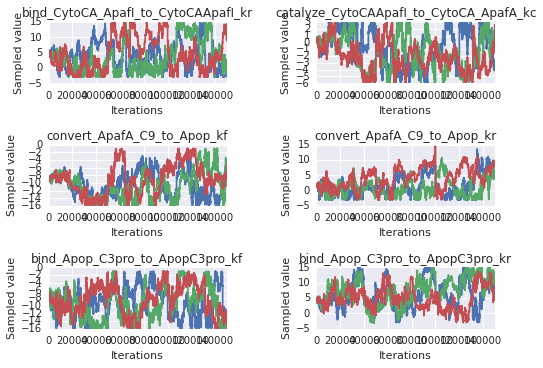

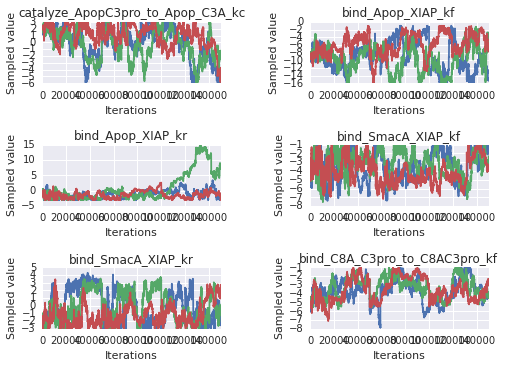

...

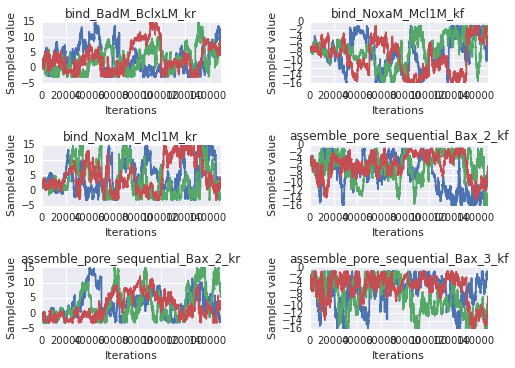

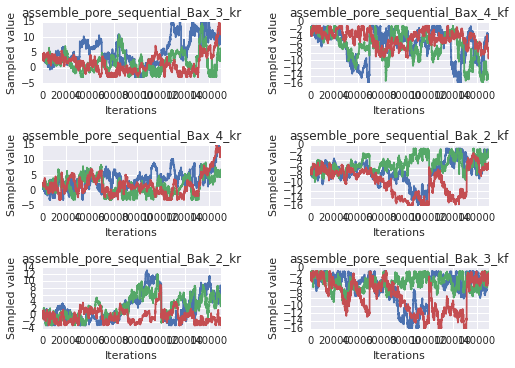

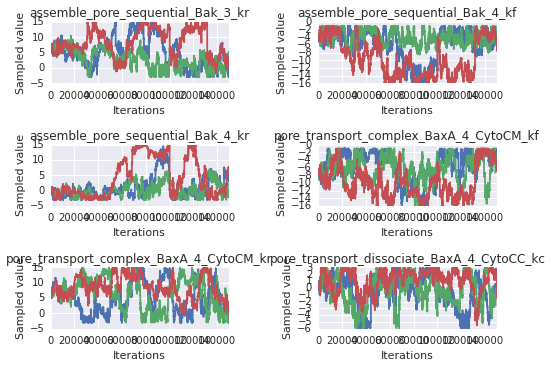

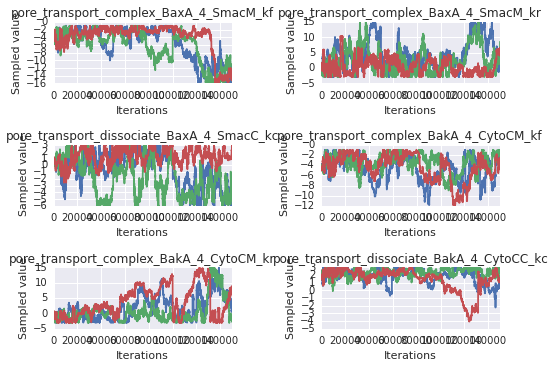

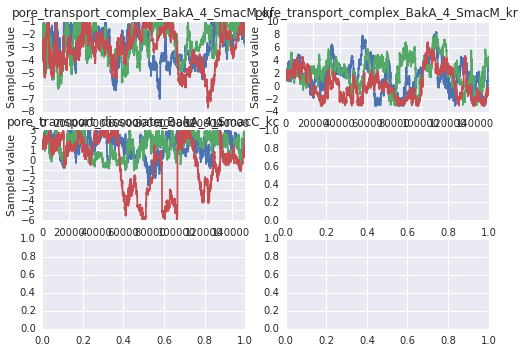

In [10]:
sample_plots(param_trace_dicts['a'])

150000
3
150000


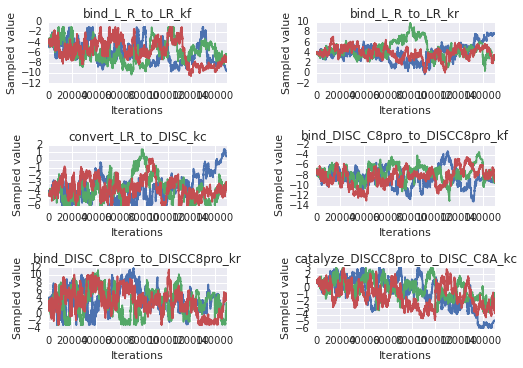

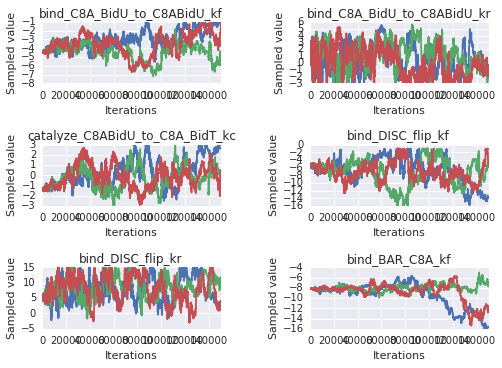

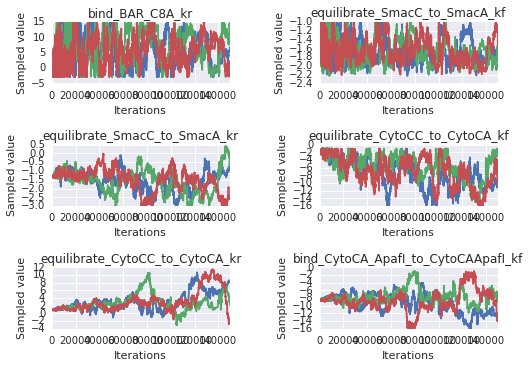

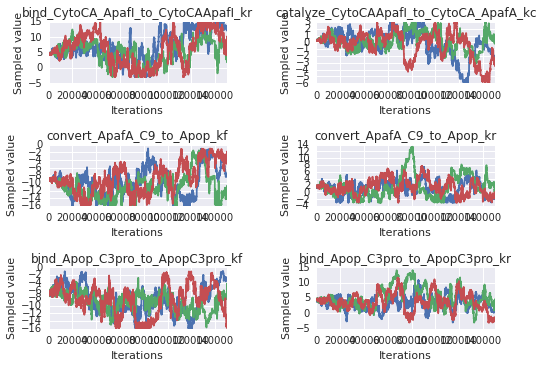

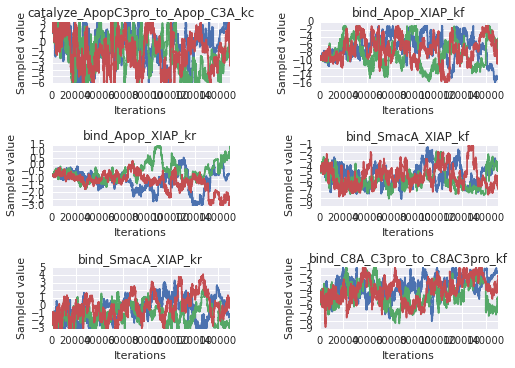

...

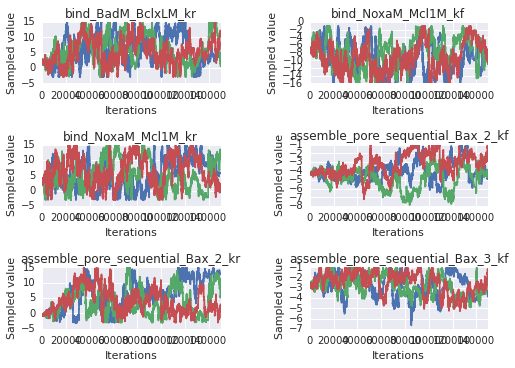

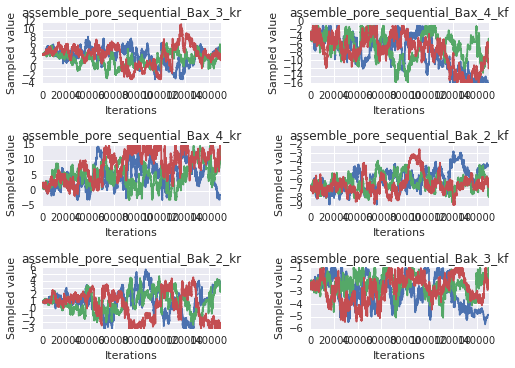

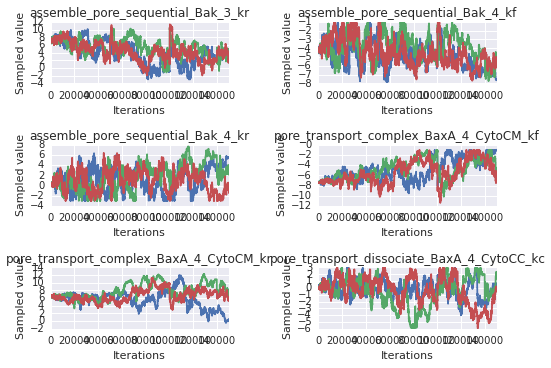

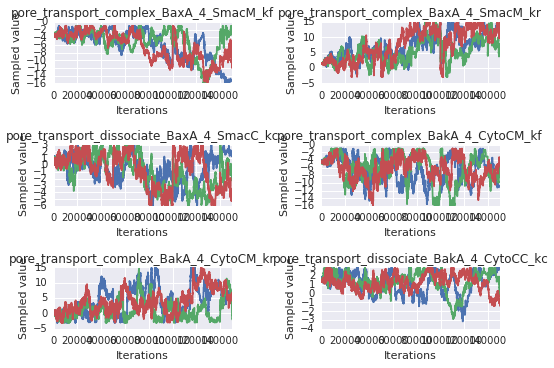

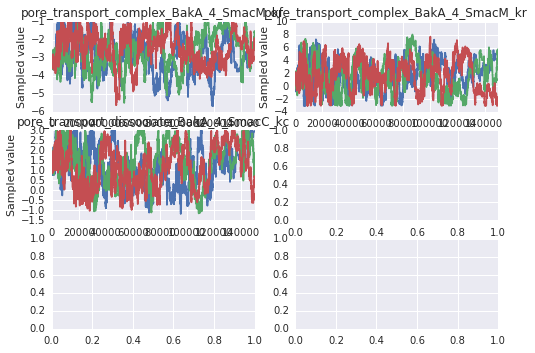

In [11]:
sample_plots(param_trace_dicts['b'])

150000
3
150000


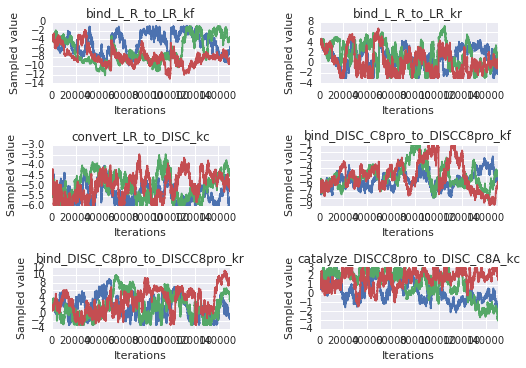

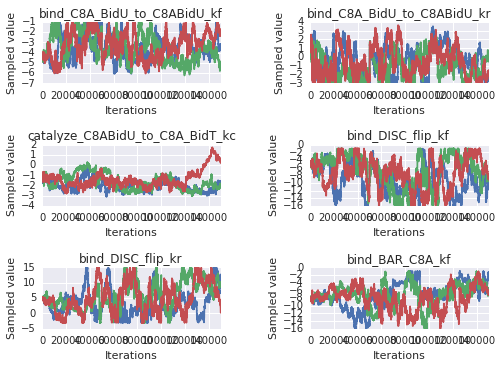

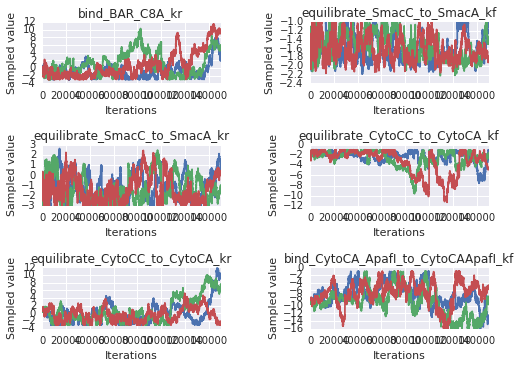

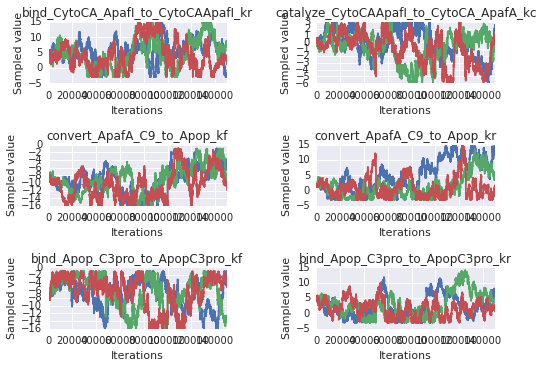

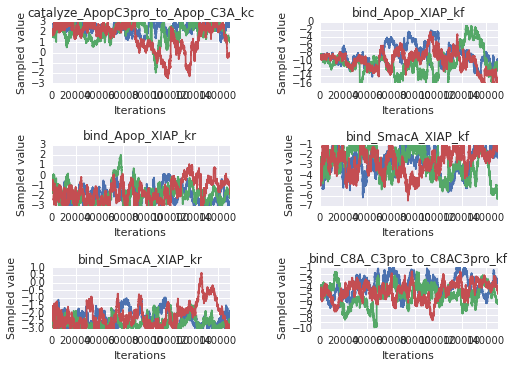

...

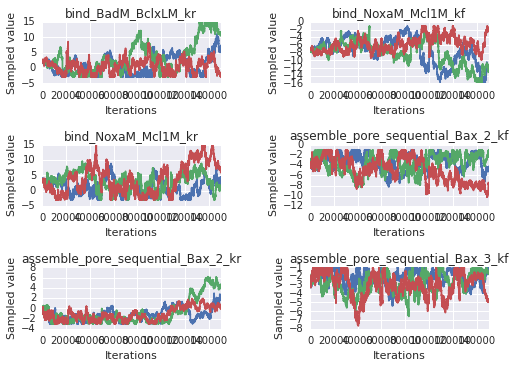

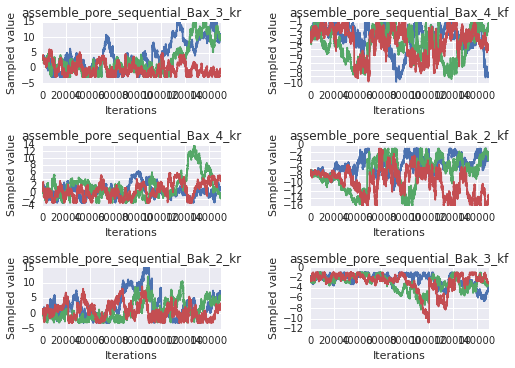

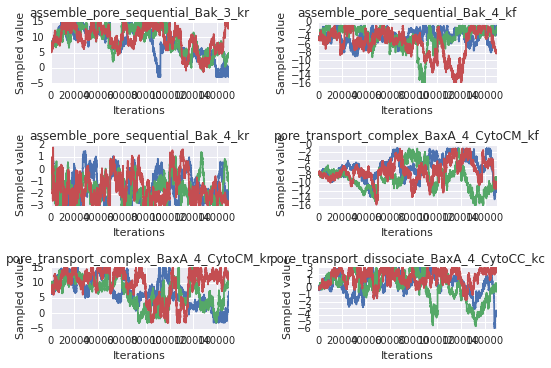

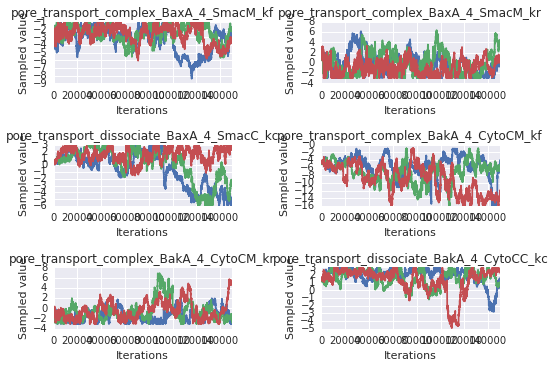

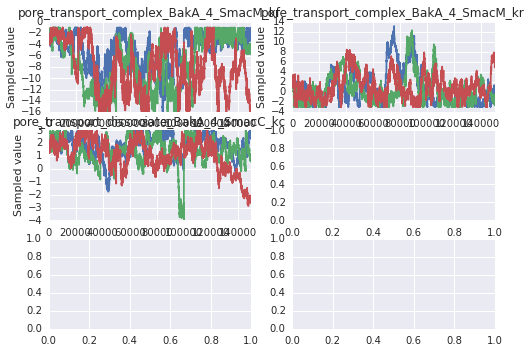

In [12]:
sample_plots(param_trace_dicts['c'])

In [14]:
trace_arr_a = create_trace_matrix(param_trace_dicts['a'], burnin=25000, thin=1)
trace_arr_b = create_trace_matrix(param_trace_dicts['b'], burnin=25000, thin=1)
trace_arr_c = create_trace_matrix(param_trace_dicts['c'], burnin=25000, thin=1)
#trace_arr_d = create_trace_matrix(param_trace_dicts['d'], burnin=25000, thin=1)

In [15]:
trace_arr_a_short = create_trace_matrix(param_trace_dicts['a'], burnin=40000, thin=1)
trace_arr_b_short = create_trace_matrix(param_trace_dicts['b'], burnin=40000, thin=1)
trace_arr_c_short = create_trace_matrix(param_trace_dicts['c'], burnin=40000, thin=1)
#trace_arr_d_short = create_trace_matrix(param_trace_dicts['d'], burnin=40000, thin=1)

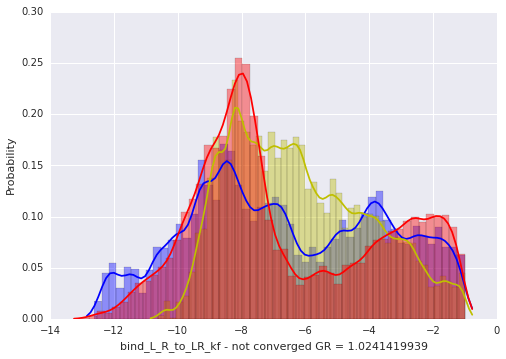

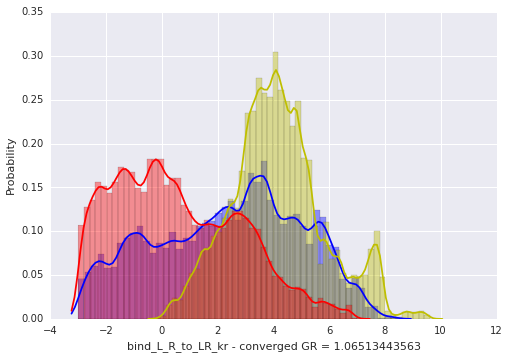

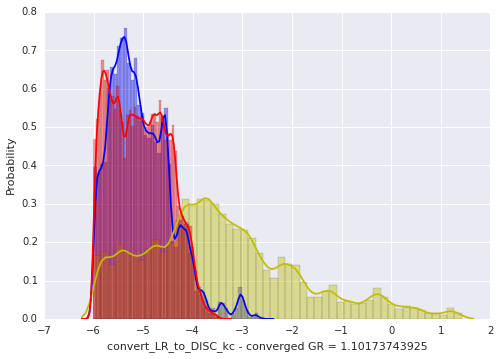

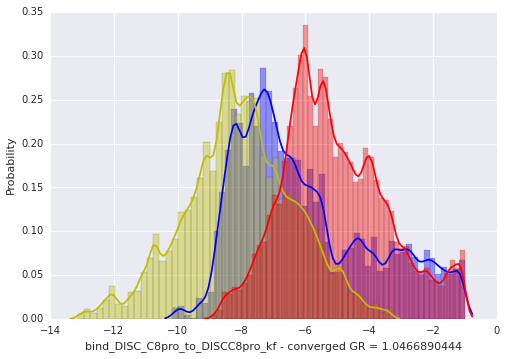

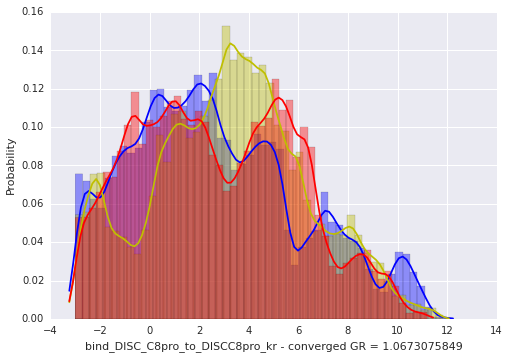

...

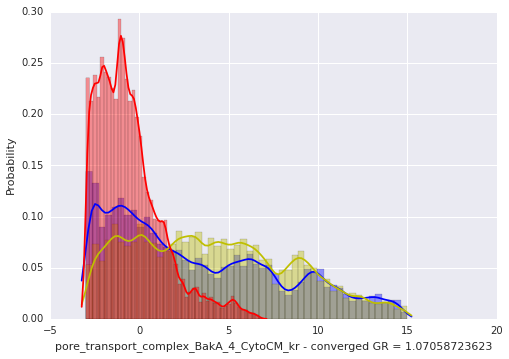

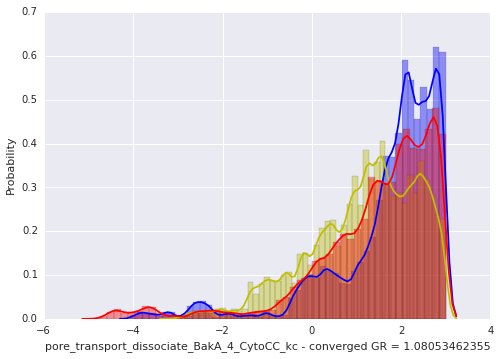

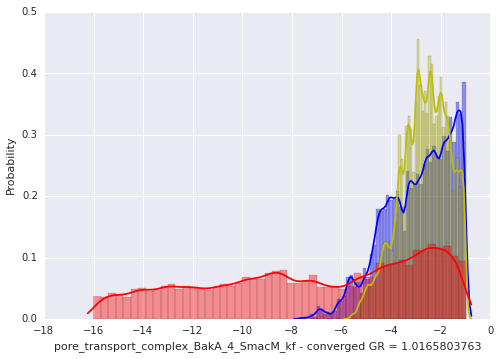

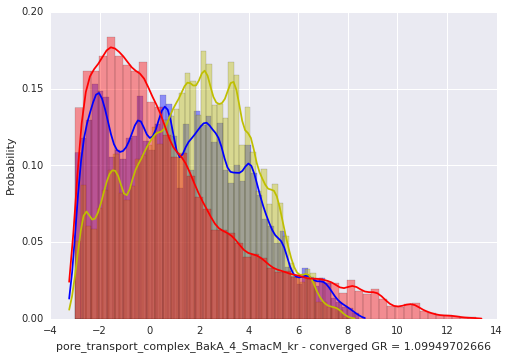

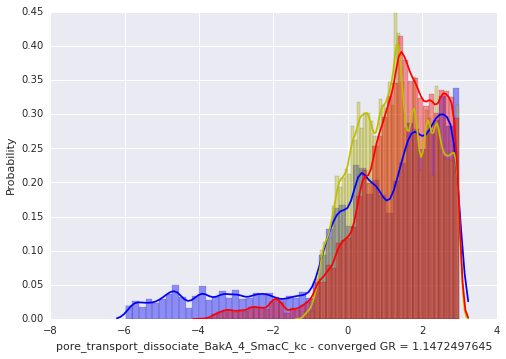

In [17]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a_short[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b_short[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c_short[:,dim], hist=True, color='r')
    #sns.distplot(trace_arr_d_short[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['c'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

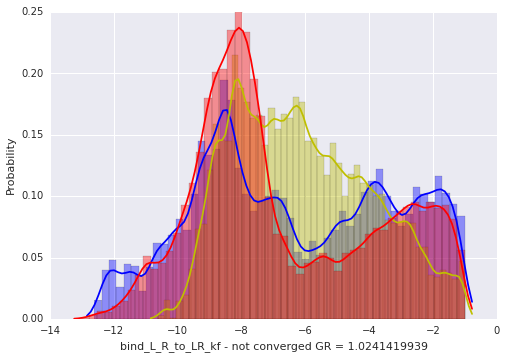

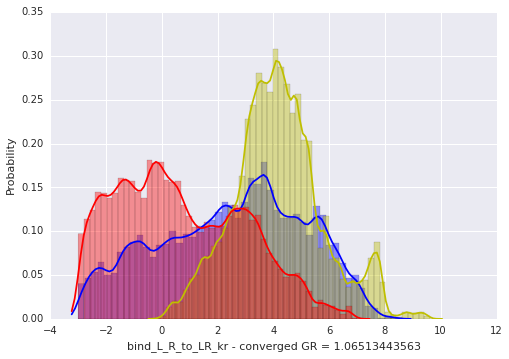

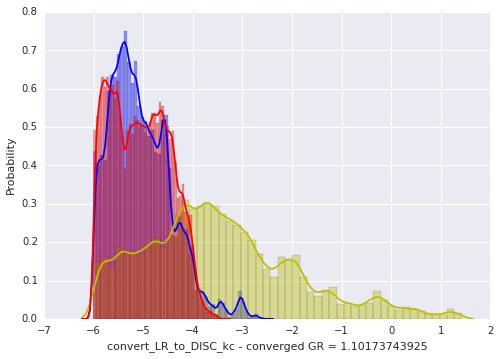

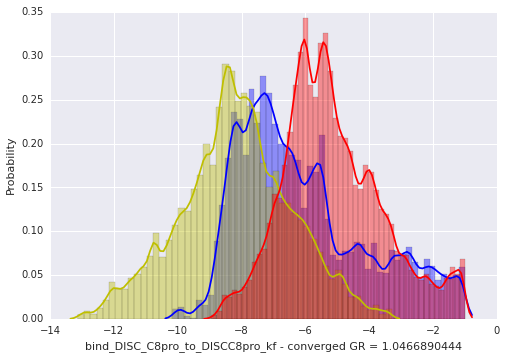

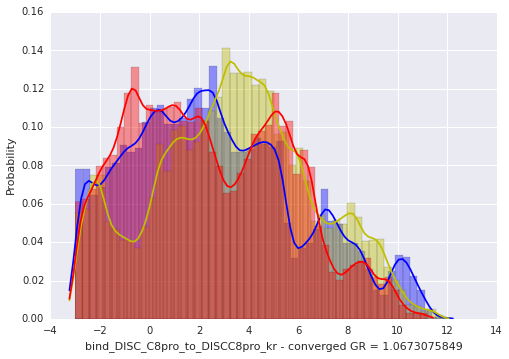

...

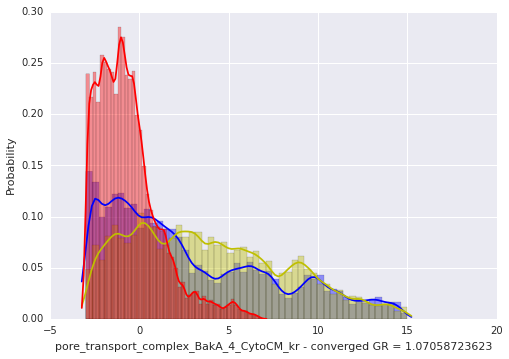

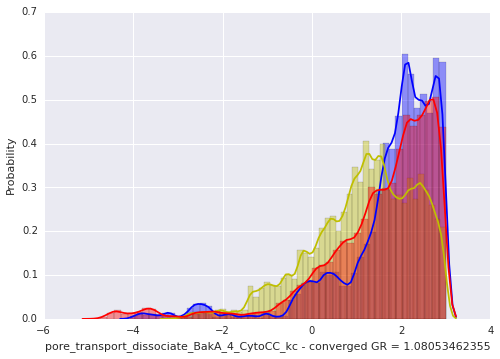

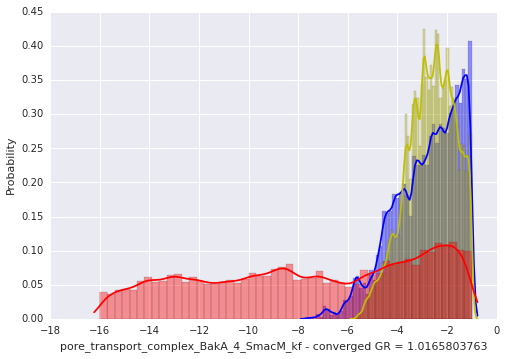

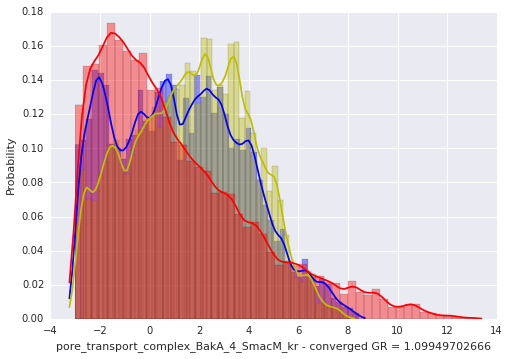

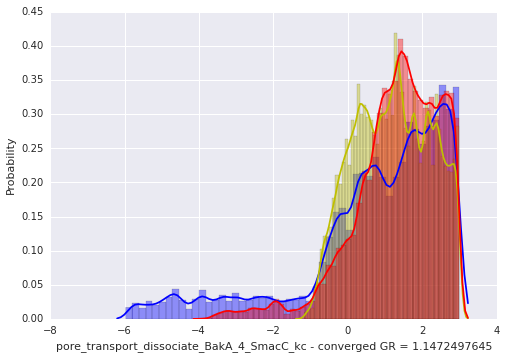

In [18]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    sns.plotting_context('notebook')
    ax = sns.distplot(trace_arr_a[:,dim], hist=True, color='b')
    sns.distplot(trace_arr_b[:,dim], hist=True, color='y')
    sns.distplot(trace_arr_c[:,dim], hist=True, color='r')
    #sns.distplot(trace_arr_d[:,dim], hist=True, color='g')
    if gelman_rubin_dicts['c'][param_name] < 1.2:
        sns.axlabel(param_name+' - converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')
    else:
        sns.axlabel(param_name+' - not converged GR = '+str(gelman_rubin_dicts['a'][param_name]), 'Probability')

In [19]:
traces['a'][1][:,0]

array([-3.63415288, -3.63415288, -3.63415288, ..., -8.61885859,
       -8.61885859, -8.61885859])

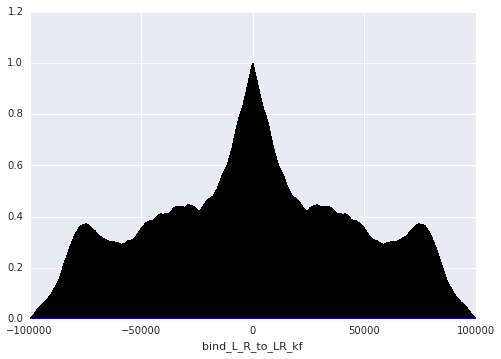

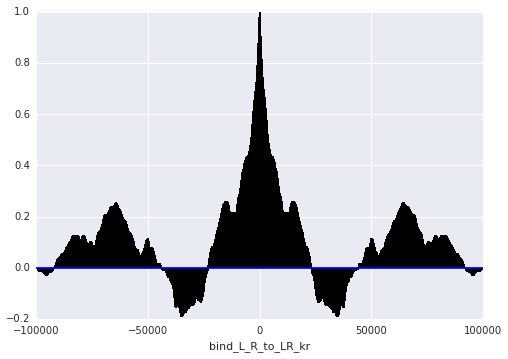

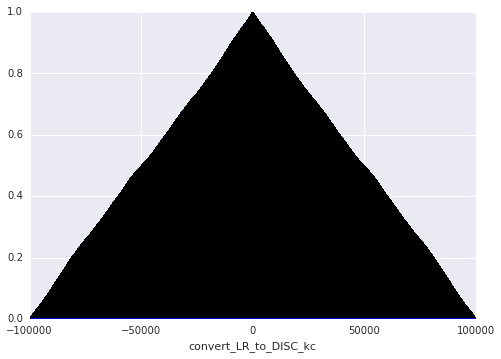

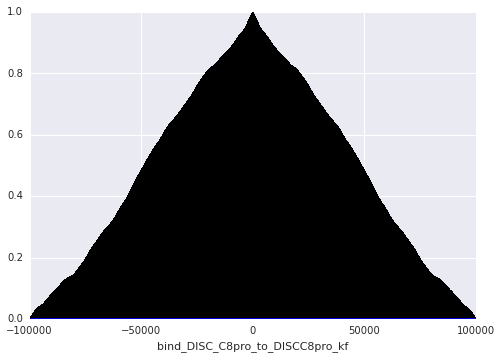

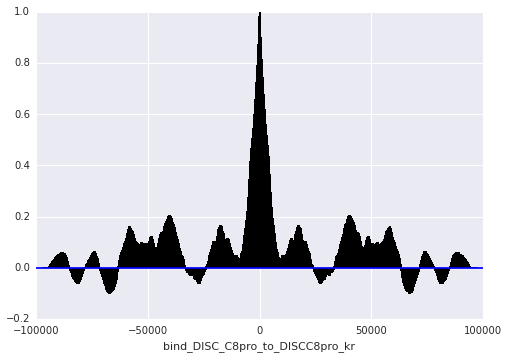

...

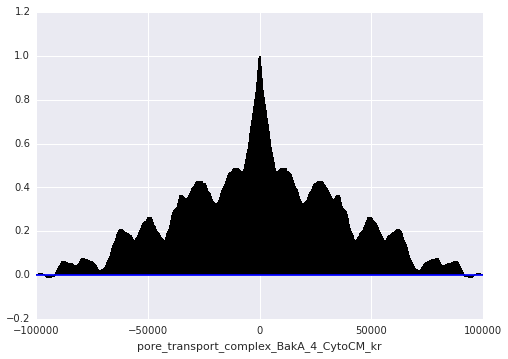

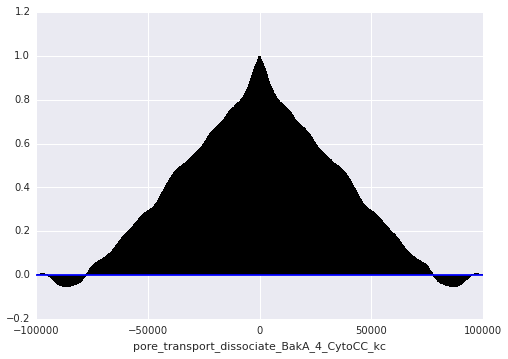

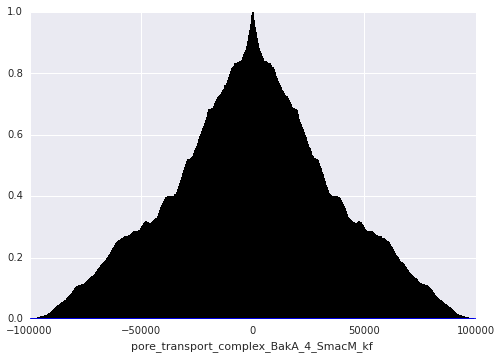

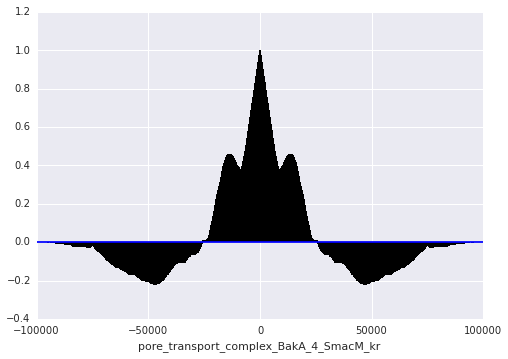

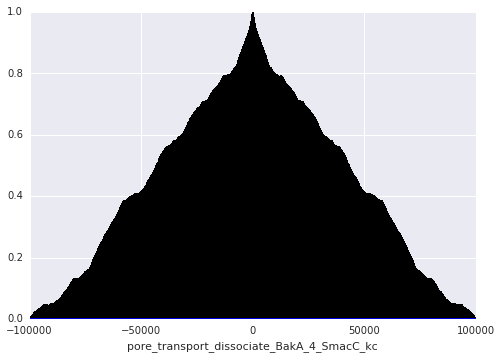

In [28]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['c'][0][50000:,dim], maxlags=None)
    plt.xlabel(str(param_name))

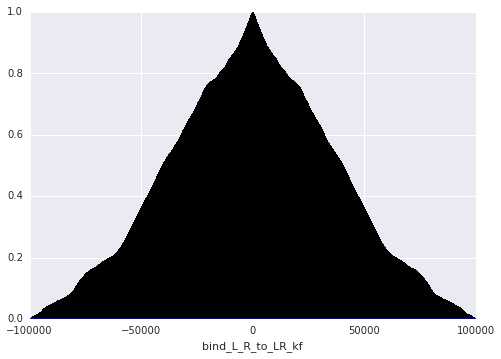

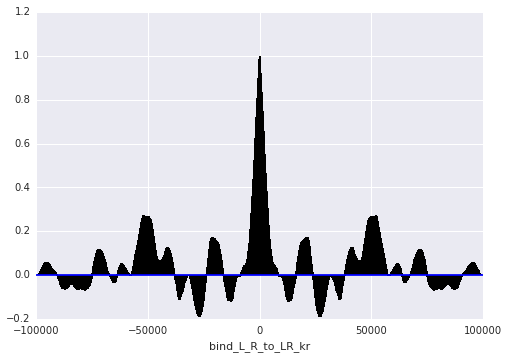

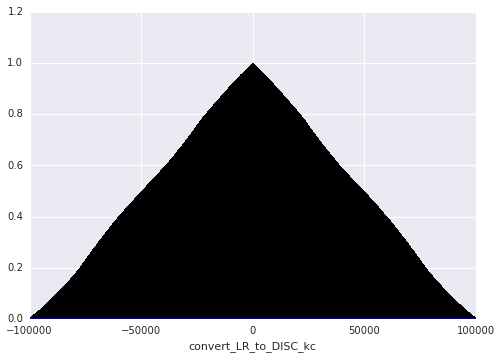

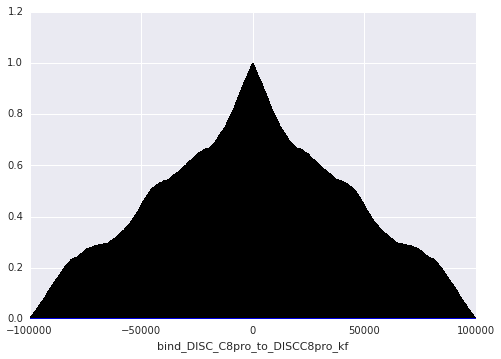

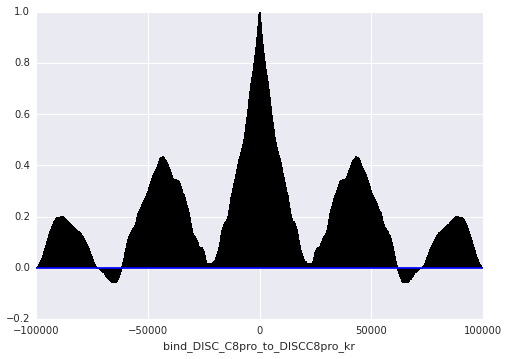

...

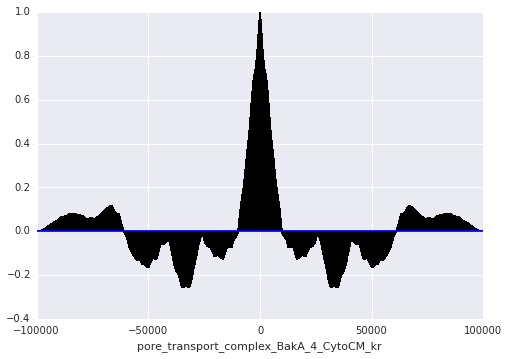

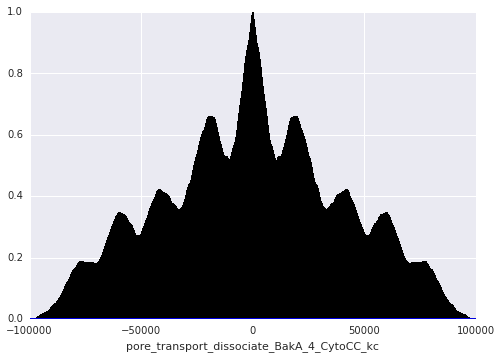

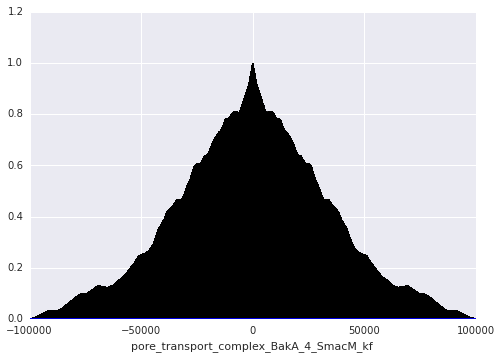

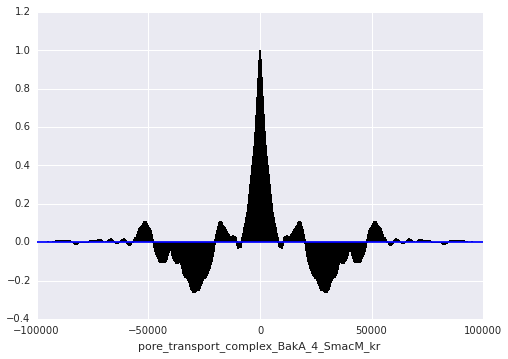

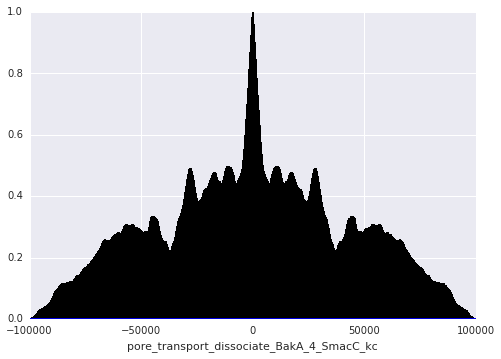

In [29]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['c'][1][50000::,dim], maxlags=None)
    plt.xlabel(str(param_name))

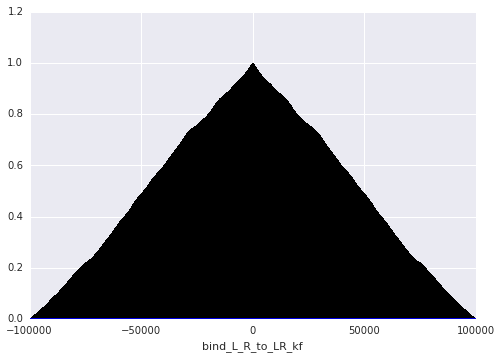

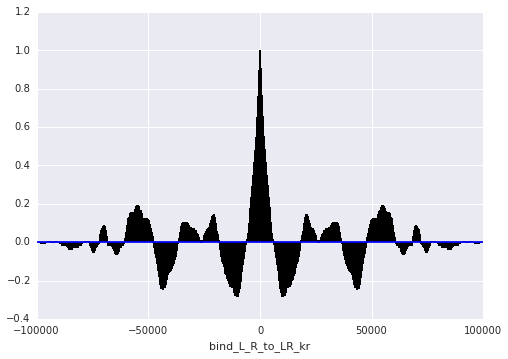

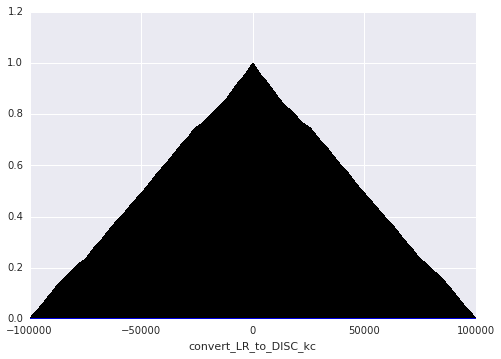

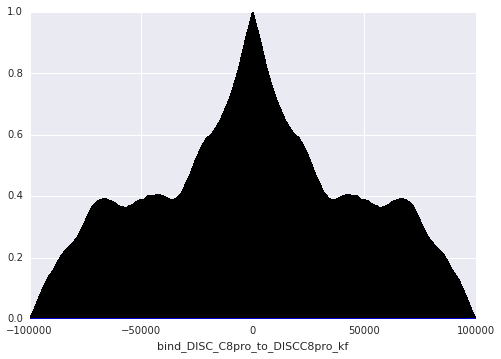

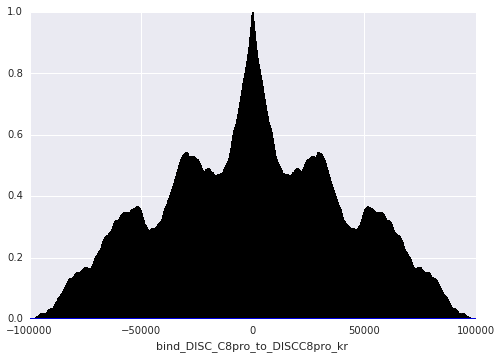

...

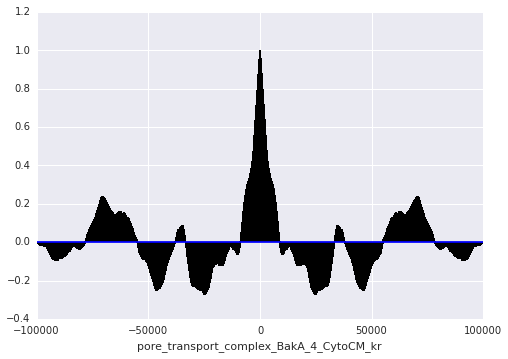

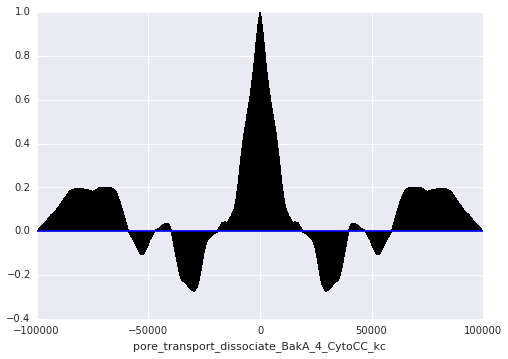

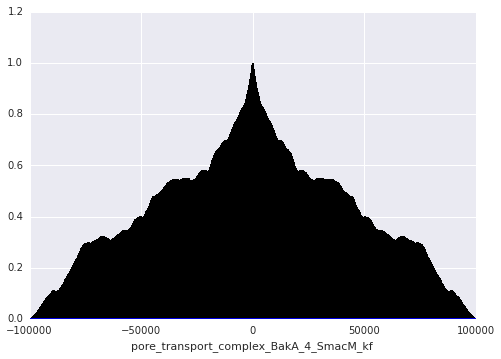

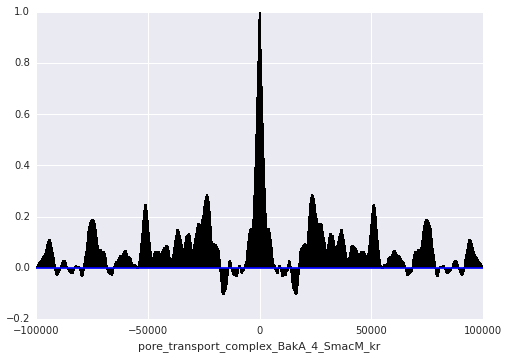

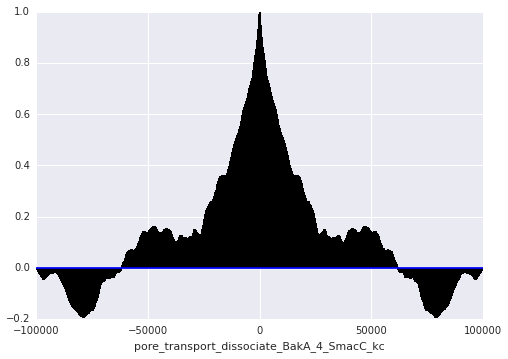

In [30]:
for dim, param_name in enumerate([param.name for param in model.parameters_rules()]):
    fig = plt.figure()
    plt.acorr(traces['c'][2][50000:,dim], maxlags=None)
    plt.xlabel(str(param_name))

In [32]:
os.chdir('/Users/Erin/git/emcee/')
from emcee import autocorr

In [44]:
range(1, 15+1)

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]

In [52]:
windows=15
integrated_autocorr_times = {}
for trace in ['a', 'b', 'c']:
    integrated_autocorr_times[trace] = {}
    for chain in range(3):
        integrated_autocorr_times[trace][chain] = np.zeros((windows, 105))
        window_length = int(len(traces[trace][chain][25000::])/windows)
        start = 25000
        for window in range(windows):
            end = start + window_length
            integrated_autocorr_times[trace][chain][window] = autocorr.integrated_time(traces[trace][chain][start:end], window=500)
            start = end
integrated_autocorr_times

{'a': {0: array([[ 677.03169826,  629.00790785,  857.70242771, ...,  797.24311613,
           768.41931461,  767.45979045],
         [ 887.81316875,  767.43596287,  871.34044263, ...,  436.52782506,
           838.34155288,  751.4563362 ],
         [ 786.20119715,  858.09669318,  775.33307999, ...,  576.73980424,
           803.29218435,  918.34122147],
         ..., 
         [ 794.38489178,  792.71514708,  650.33864418, ...,  640.51599585,
           757.33936908,  727.0450624 ],
         [ 894.28045647,  758.75982038,  849.06586002, ...,  535.55494245,
           767.59823439,  471.47823598],
         [ 797.61188114,  775.68778617,  932.74390332, ...,  518.17653605,
           847.47563594,  801.80277284]]),
  1: array([[ 652.39544006,  624.52647491,  870.25292286, ...,  705.32659066,
           849.24953184,  629.29479451],
         [ 748.56453897,  859.16368421,  812.51763975, ...,  863.95798608,
           735.29906914,  669.53744216],
         [ 559.49727075,  649.4514562 ,  636

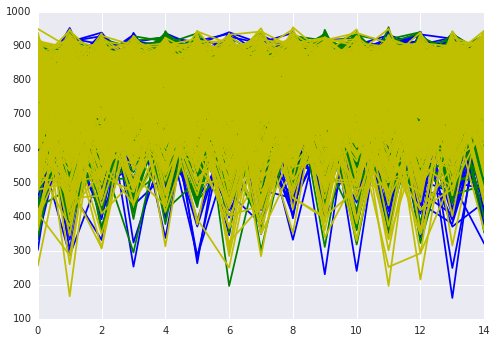

In [53]:
for trace in ['a', 'b', 'c']:
    for chain in range(3):
        for dim in range(105):
            if trace == 'a':
                plt.plot(range(15), integrated_autocorr_times[trace][chain][:,dim], 'b')
            elif trace == 'b':
                plt.plot(range(15), integrated_autocorr_times[trace][chain][:,dim], 'g')
            elif trace == 'c':
                plt.plot(range(15), integrated_autocorr_times[trace][chain][:,dim], 'y')

In [ ]:
corner(trace_arr_a[:,50:60:], labels=param_trace_dict_a['param_list'][50:60], bins=10)

In [22]:
acceptance_rates = {}
vector_acceptance_rate = {}
running_acceptance_rates = {}
running_acceptance_rates_100window = {}
n_vector_acceptances = {}
n_100windowvec_acceptances = {}
running_acceptance_rates_vec = {}
running_acceptances_rates_vec_100window = {}
n_100window_acceptances = {}
n_acceptances = {}
for run in ['a', 'b', 'c']:
    acceptance_rates[run] = {}
    vector_acceptance_rate[run] = {}
    running_acceptance_rates[run] = {}
    running_acceptance_rates_100window[run] = {}
    n_vector_acceptances[run] = {}
    n_100windowvec_acceptances[run] = {}
    running_acceptance_rates_vec[run] = {}
    running_acceptances_rates_vec_100window[run] = {}
    n_100window_acceptances[run] = {}
    n_acceptances[run] = {}
    for chain in range(len(traces[run])):
        acceptance_rates[run][chain] = np.zeros((len(traces['c'][0][0],)))
        vector_acceptance_rate[run][chain] = 0
        running_acceptance_rates[run][chain] = np.zeros((len(traces['c'][0][0]), len(traces['c'][0])))
        running_acceptance_rates_100window[run][chain] = np.zeros((len(traces['c'][0][0]), 1500))
        n_vector_acceptances[run][chain] = 0
        n_100windowvec_acceptances[run][chain] = 0
        running_acceptance_rates_vec[run][chain] = np.zeros((1, len(traces['c'][0])))
        running_acceptances_rates_vec_100window[run][chain] = np.zeros((1, 1500))
        n_100window_acceptances[run][chain] = {}
        n_acceptances[run][chain] = {}
        for dim in range(len(traces[run][chain][0])):
            n_100window_acceptances[run][chain][dim] = 0
            n_acceptances[run][chain][dim] = 0
            for iteration in range(1, len(traces[run][chain])):
                if dim == 0:
                    comparison = traces[run][chain][iteration] == traces[run][chain][iteration-1]
                    if not np.all(comparison):
                        n_vector_acceptances[run][chain] += 1
                        n_100windowvec_acceptances[run][chain] += 1
                    running_acceptance_rates_vec[run][chain][0, iteration] = float(n_vector_acceptances[run][chain])/iteration
                    if iteration % 100 == 0:
                        running_acceptances_rates_vec_100window[run][chain][0, iteration/100] = float(n_100windowvec_acceptances[run][chain])/100
                        n_100windowvec_acceptances[run][chain] = 0
                if traces[run][chain][iteration][dim] != traces[run][chain][iteration-1][dim]:
                    n_acceptances[run][chain][dim] += 1
                    n_100window_acceptances[run][chain][dim] += 1
                running_acceptance_rates[run][chain][dim, iteration] = float(n_acceptances[run][chain][dim])/iteration
        
                if iteration % 100 == 0:
                    running_acceptance_rates_100window[run][chain][dim, iteration/100] = float(n_100window_acceptances[run][chain][dim])/100
                    n_100window_acceptances[run][chain][dim] = 0
            
            acceptance_rates[run][chain][dim] = float(n_acceptances[run][chain][dim])/len(traces[run][chain])
            print 'N acceptances for parameter: ',str(param_trace_dict_a['param_list'][dim]),' = ',str(n_acceptances[run][chain][dim]),' acceptance rate: ',str(acceptance_rates[run][chain][dim])
        print 'n vector acceptances: ',n_vector_acceptances[run][chain],' for run: ',run,' and chain: ',chain
        print 'Acceptance rate for vector: ',float(n_vector_acceptances[run][chain])/len(traces[run][chain]),' for run: ',run,' and chain: ',chain
running_acceptance_rates
running_acceptance_rates_100window
running_acceptance_rates_vec
running_acceptances_rates_vec_100window


N acceptances for parameter:  bind_L_R_to_LR_kf  =  12020  acceptance rate:  0.0801333333333
N acceptances for parameter:  bind_L_R_to_LR_kr  =  12895  acceptance rate:  0.0859666666667
N acceptances for parameter:  convert_LR_to_DISC_kc  =  12550  acceptance rate:  0.0836666666667
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kf  =  12237  acceptance rate:  0.08158
N acceptances for parameter:  bind_DISC_C8pro_to_DISCC8pro_kr  =  12994  acceptance rate:  0.0866266666667
N acceptances for parameter:  catalyze_DISCC8pro_to_DISC_C8A_kc  =  12786  acceptance rate:  0.08524
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kf  =  12833  acceptance rate:  0.0855533333333
N acceptances for parameter:  bind_C8A_BidU_to_C8ABidU_kr  =  12828  acceptance rate:  0.08552
N acceptances for parameter:  catalyze_C8ABidU_to_C8A_BidT_kc  =  12371  acceptance rate:  0.0824733333333
N acceptances for parameter:  bind_DISC_flip_kf  =  12925  acceptance rate:  0.0861666666667
N acceptance

{'a': {0: array([[ 0.  ,  0.11,  0.27, ...,  0.04,  0.12,  0.03]]),
  1: array([[ 0.  ,  0.08,  0.2 , ...,  0.17,  0.09,  0.06]]),
  2: array([[ 0.  ,  0.13,  0.25, ...,  0.11,  0.04,  0.12]])},
 'b': {0: array([[ 0.  ,  0.1 ,  0.14, ...,  0.01,  0.  ,  0.  ]]),
  1: array([[ 0.  ,  0.04,  0.23, ...,  0.1 ,  0.07,  0.05]]),
  2: array([[ 0.  ,  0.12,  0.15, ...,  0.03,  0.01,  0.02]])},
 'c': {0: array([[ 0.  ,  0.09,  0.3 , ...,  0.11,  0.06,  0.06]]),
  1: array([[ 0.  ,  0.14,  0.25, ...,  0.12,  0.14,  0.13]]),
  2: array([[ 0.  ,  0.08,  0.24, ...,  0.04,  0.05,  0.07]])}}

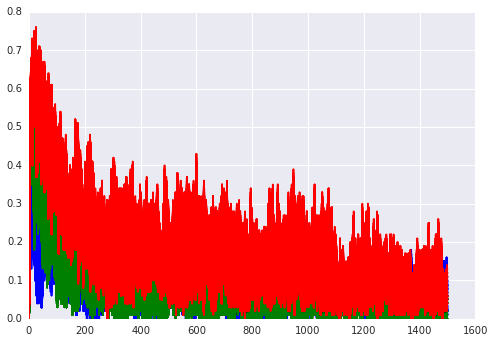

In [24]:
for run in ['a', 'b', 'c']:
    for chain in range(len(traces[run])):
        for dim in range(105):
            if run == 'a':
                plt.plot(range(1500), running_acceptance_rates_100window[run][chain][dim, :], 'b')
            elif run == 'b':
                plt.plot(range(1500), running_acceptance_rates_100window[run][chain][dim, :], 'g')
            elif run == 'c':
                plt.plot(range(1500), running_acceptance_rates_100window[run][chain][dim, :], 'r')
            elif run == 'd':
                plt.plot(range(1500), running_acceptance_rates_100window[run][chain][dim, :], 'y')

In [25]:
adapted_crossover_vals = {}
adapted_gamma_vals = {}
joint_probs = {}
for run in ['a', 'b', 'c']:
    adapted_gamma_vals[run] = np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+run+'_DREAM_chain_adapted_gammalevelprob.npy')
    adapted_crossover_vals[run] = np.load('earm_mtdreamzs_3chain_uniform_gammalevels_25000burnin_'+run+'_DREAM_chain_adapted_crossoverprob.npy')
    #joint_probs[run] = adapted_crossover_vals[run]*[adapted_gamma_vals[run][level] for level in range(len(adapted_gamma_vals[run]))]


In [26]:
adapted_crossover_vals

{'a': array([ 0.26511556,  0.23853595,  0.49634849]),
 'b': array([  1.43018899e-05,   2.98577311e-01,   7.01408387e-01]),
 'c': array([ 0.14644888,  0.19418167,  0.65936946])}

In [27]:
adapted_gamma_vals

{'a': array([ 0.48420182,  0.24993772,  0.1260606 ,  0.13979985]),
 'b': array([  5.66577404e-01,   4.33316177e-01,   1.70948657e-05,
          8.93246938e-05]),
 'c': array([  5.37887894e-23,   2.49438741e-01,   7.01272817e-01,
          4.92884419e-02])}